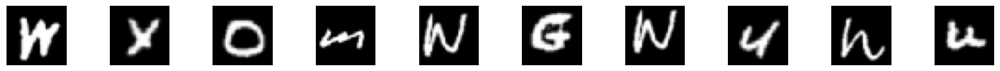

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import utils
import torch

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch.optim as optim

from sklearn.model_selection import train_test_split

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

loaded_images = utils.load_images_from_zip()
emnist_data, emnist_labels = utils.load_true_emnist()

emnist_data = emnist_data.astype(np.float32)
loaded_images = loaded_images.astype(np.float32)

utils.plot_images(loaded_images[10:20])

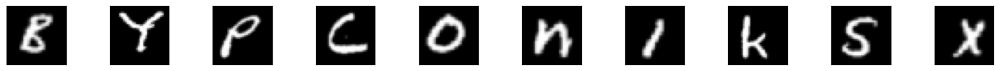

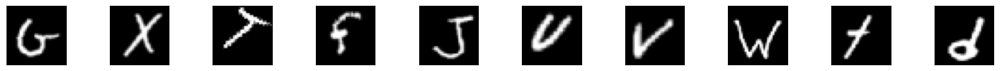

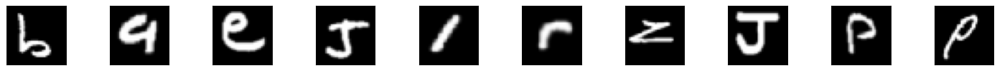

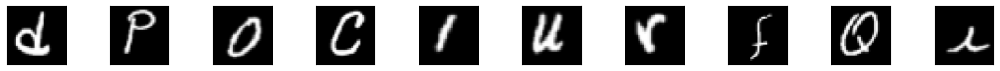

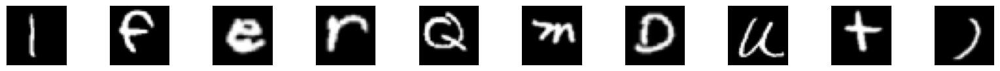

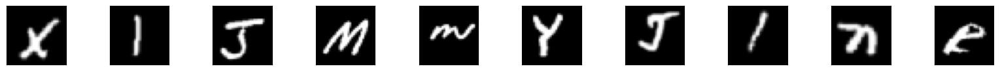

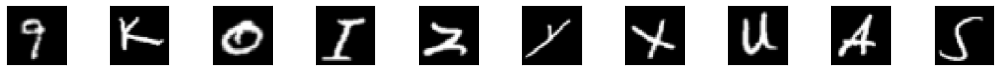

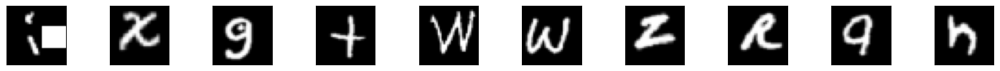

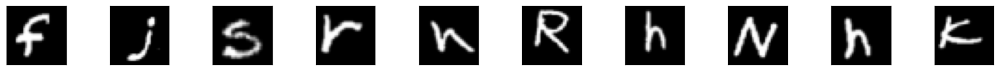

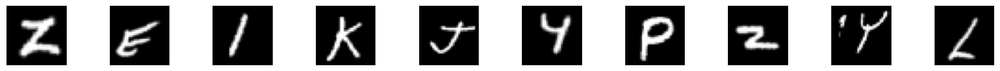

In [2]:
indexes = np.random.choice(len(loaded_images), 100, replace=False)
data = torch.tensor(loaded_images[indexes]).float().to(device)
utils.plot_images(data)

In [3]:
import torch.nn as nn
import torch.nn.functional as F
from sklearn.model_selection import train_test_split
import torch.optim as optim

loaded_images_nn = torch.tensor(
    np.reshape(loaded_images, (len(loaded_images), 32 * 32)), 
    device=device,
    dtype=torch.float32
    )
data_train, data_test = train_test_split(loaded_images_nn, test_size=0.2, random_state=1)

train_loader = torch.utils.data.DataLoader(data_train, batch_size=256, shuffle=True)
test_loader = torch.utils.data.DataLoader(data_test, batch_size=256, shuffle=False)


Model structure coming from [here](https://www.geeksforgeeks.org/implement-convolutional-autoencoder-in-pytorch-with-cuda/)


In [89]:
class Reshape(nn.Module):
    def __init__(self, *args):
        super(Reshape, self).__init__()
        self.shape = args

    def forward(self, x):
        return x.view(*self.shape)


class Autoencoder(nn.Module):
    def __init__(self, input_dim=data_train.shape[1]):
        super(Autoencoder, self).__init__()
        self.img_size = int(np.sqrt(input_dim))
        
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 16, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Conv2d(16, 8, kernel_size=3, stride=1, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2),
            nn.Flatten(),
            nn.Linear(8 * (self.img_size//4) * (self.img_size//4), 32),
            nn.ReLU()
        )
        
        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(32, 8 * (self.img_size//4) * (self.img_size//4)),
            nn.ReLU(),
            Reshape(-1, 8, self.img_size//4, self.img_size//4),
            nn.ConvTranspose2d(8, 16, 
                              kernel_size=3, 
                              stride=2, 
                              padding=1, 
                              output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(16, 1, 
                              kernel_size=3, 
                              stride=2, 
                              padding=1, 
                              output_padding=1),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        if len(x.shape) == 2:
            x = x.view(-1, 1, self.img_size, self.img_size)
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return decoded.view(-1, self.img_size * self.img_size)

In [90]:
model = Autoencoder()
model = model.to(device)

optimizer = optim.Adam(model.parameters())
loss_fn = torch.nn.MSELoss()

In [91]:
def train_model(model, loss_fn, data_loader=None, epochs=10, optimizer=None):
    model.train()
    for epoch in range(epochs):
        for batch_idx, data in enumerate(train_loader):
            optimizer.zero_grad()
            output = model(data)
            loss = loss_fn(output, data)
            loss.backward()
            optimizer.step()
            if batch_idx % 100 == 0:
                print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                    epoch, batch_idx * len(data), len(data_loader.dataset),
                    100. * batch_idx / len(data_loader), loss.data.item()))


In [92]:
train_model(model, loss_fn, data_loader=train_loader, epochs=10, optimizer=optimizer)

Train Epoch: 0 [0/104845 (0%)]	Loss: 0.203100
Train Epoch: 0 [25600/104845 (24%)]	Loss: 0.074949
Train Epoch: 0 [51200/104845 (49%)]	Loss: 0.062124
Train Epoch: 0 [76800/104845 (73%)]	Loss: 0.047043


KeyboardInterrupt: 

In [16]:
from utils import to_img

def plot_reconstructions2(model, data, base_dim=32):
    """
    Plot reconstructions from a dataset set.
    The top row is the original digits,
    the middle row is the encoded vector,
    and the bottom row is the decoder reconstruction.
    """
    
    true_imgs = data
    # Reshape data for the encoder
    data = data.view(-1, 1, base_dim, base_dim)  # Add this line
    # Encode and then decode the images
    encoded_imgs = model.encoder(data)
    decoded_imgs = model.decoder(encoded_imgs)

    # Convert images for plotting
    true_imgs = to_img(true_imgs, base_dim=base_dim)
    decoded_imgs = to_img(decoded_imgs, base_dim=base_dim)
    encoded_imgs = encoded_imgs.cpu().data.numpy()

    n = 10  # Number of images to display at the same time
    for j in range(0, len(data), 10):
        plt.figure(figsize=(20, 4))
        for i in range(n):
            if i+j >= len(data):
                break
            # Display original images
            ax = plt.subplot(3, n, i + 1)
            plt.imshow(true_imgs[i + j])
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            # Display encoded representations
            ax = plt.subplot(3, n, i + 1 + n)
            plt.imshow(encoded_imgs[i + j].reshape(-1, 4))
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            # Display reconstructed images
            ax = plt.subplot(3, n, i + 1 + 2 * n)
            plt.imshow(decoded_imgs[i + j])
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

/var/folders/3l/_hdyb1rx2yq_frxtjyy_t_7m0000gn/T/ipykernel_24019/827936534.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 4))


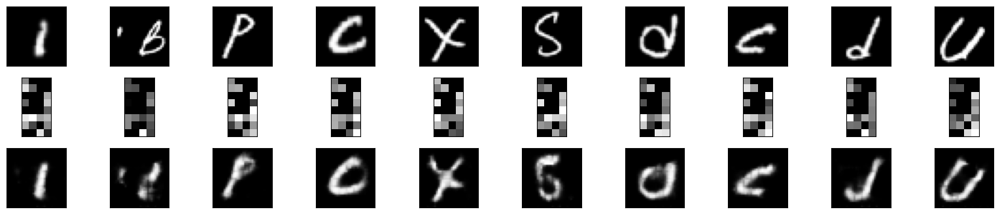

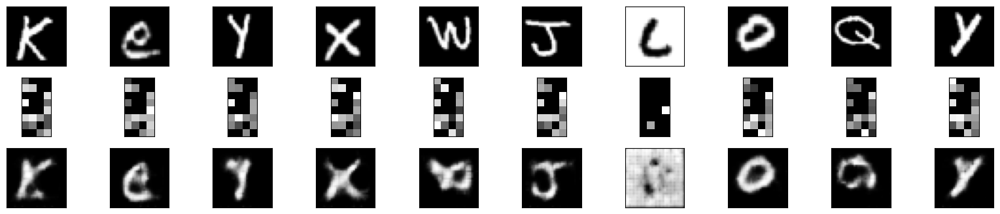

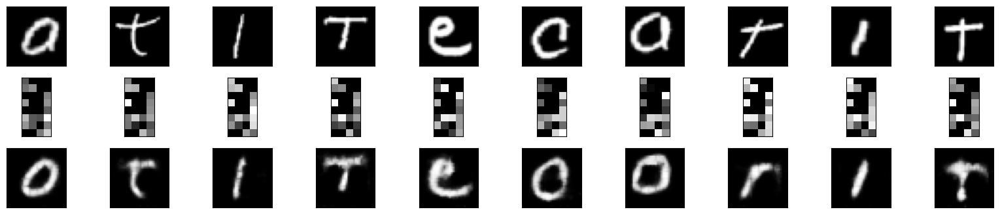

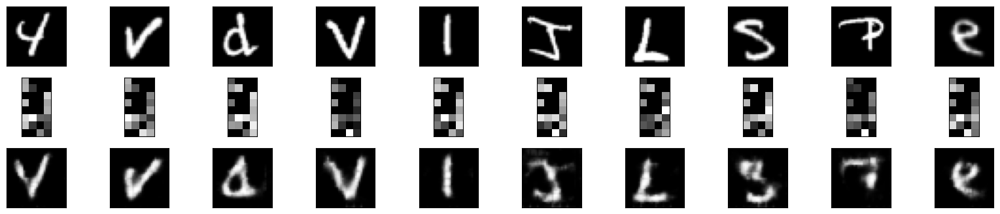

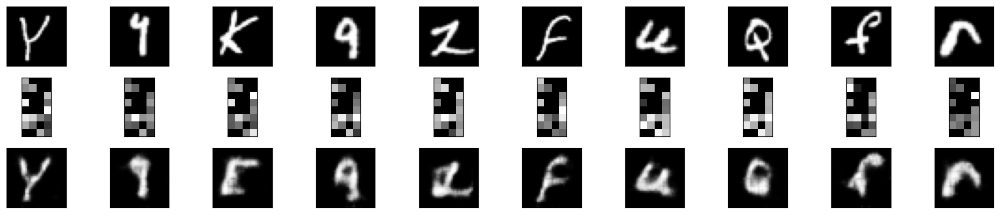

...

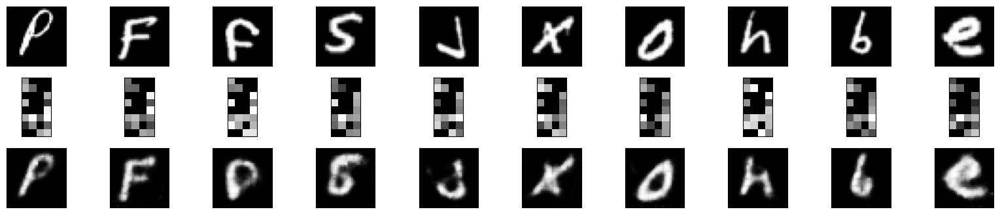

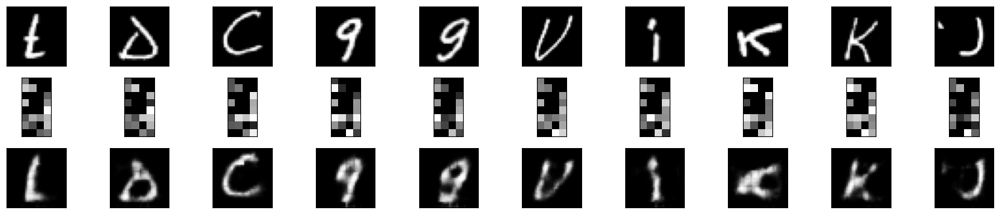

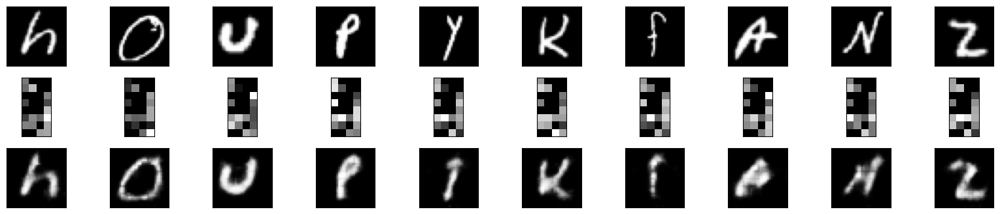

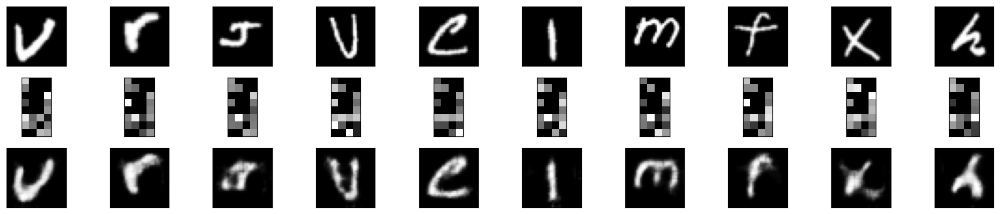

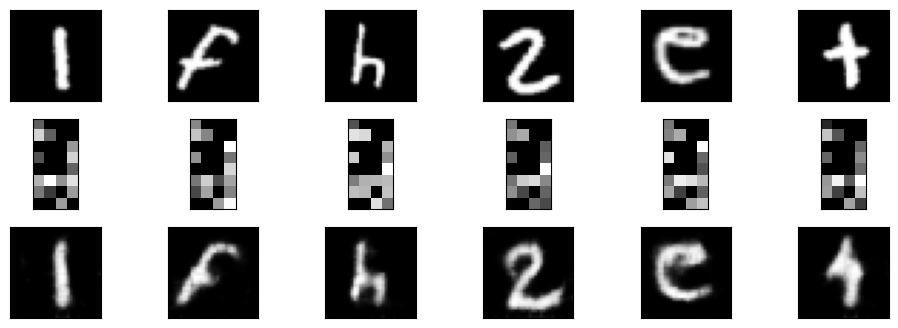

In [35]:
data_viz = next(iter(test_loader))
plot_reconstructions2(model, data_viz)

In [10]:
import seaborn as sns

eval_loss = torch.nn.MSELoss(reduction='none')
losses = eval_loss(model(data_test), data_test).sum(axis=1).detach().cpu().numpy()


sns.histplot(losses, bins=100, kde=True)
plt.axvline(x=80, color='r', linestyle='--', label='Abnormal reconstruction threshold')
plt.title('Loss distribution')
plt.legend()
plt.show()

AttributeError: 'tuple' object has no attribute 'size'

torch.Size([95, 1024])


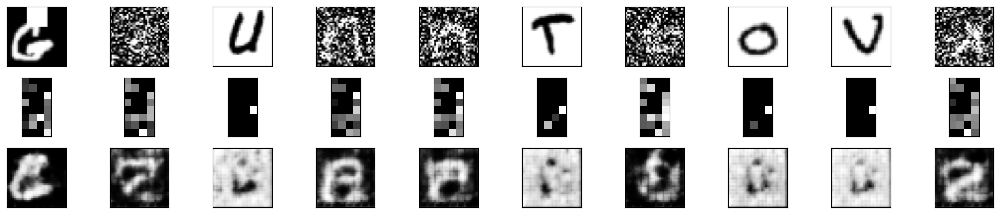

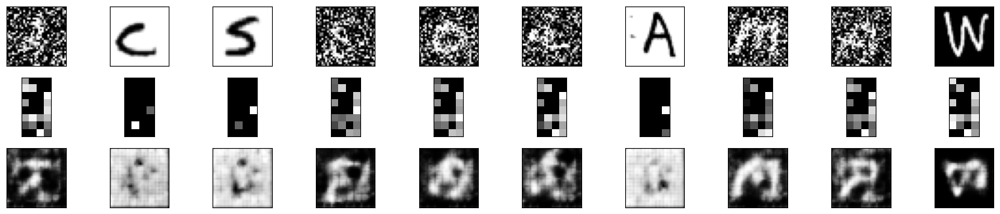

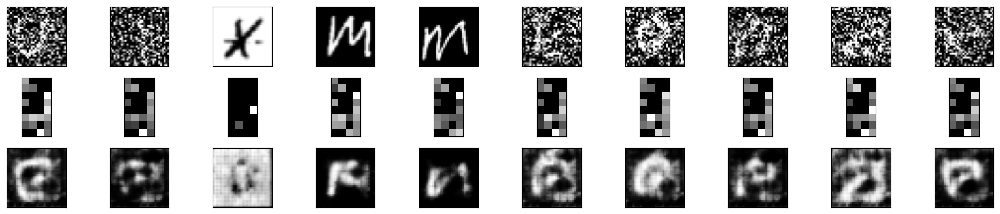

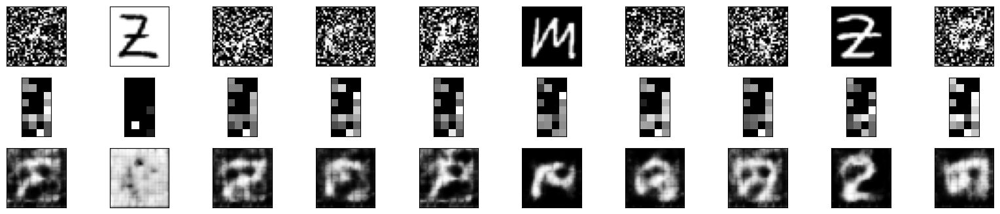

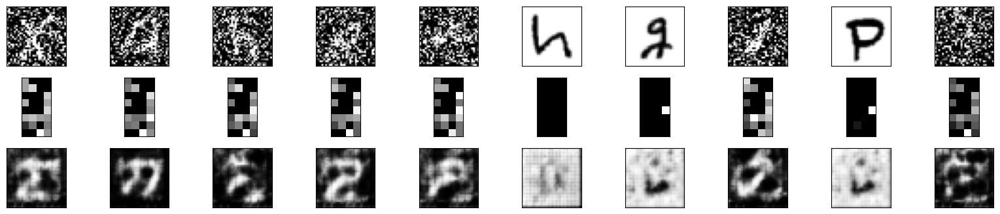

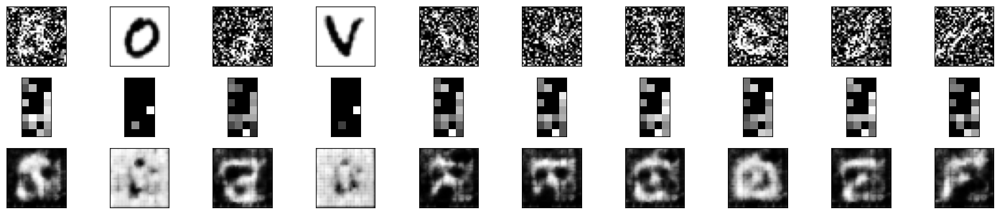

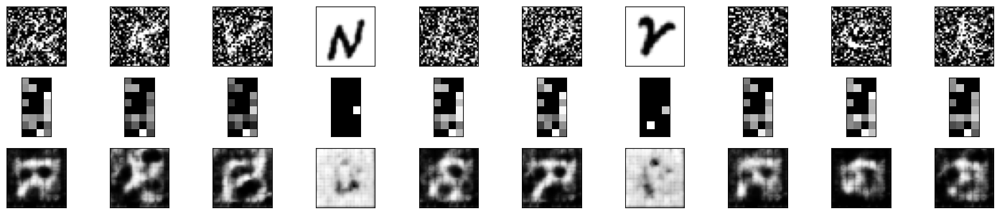

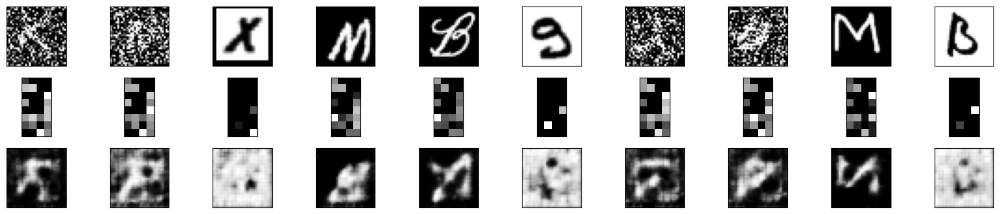

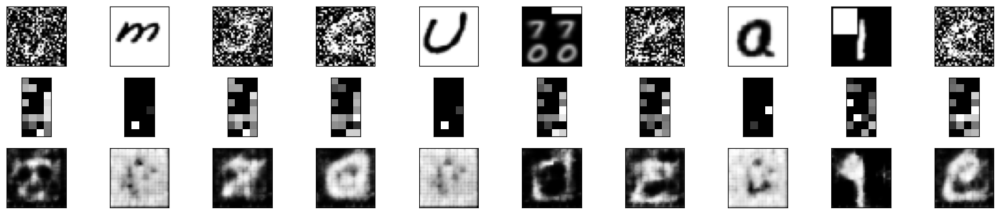

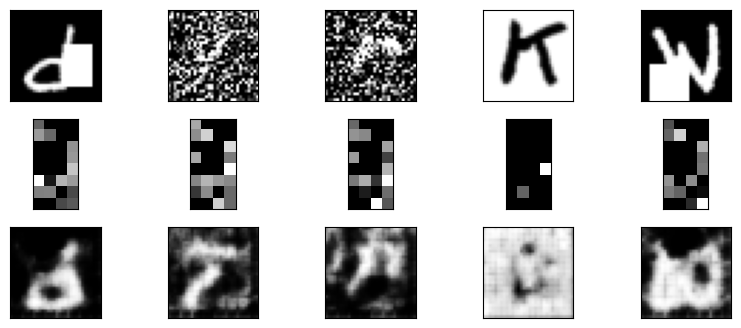

In [37]:
mask = losses > 80
outliers = data_test[mask]
print(outliers.shape)
plot_reconstructions2(model, outliers)

All the captures instances are corrupted ones, with more various examples than previously (noise, white, with white square, errors or duplicata)

## Tentative VAE 

In [4]:
import torch.nn as nn
import torch


class Encoder(nn.Module):
    
    def __init__(self, input_dim, hidden_dim, latent_dim):
        super(Encoder, self).__init__()

        self.FC_input = nn.Linear(input_dim, hidden_dim)
        self.FC_input2 = nn.Linear(hidden_dim, hidden_dim)
        self.FC_mean  = nn.Linear(hidden_dim, latent_dim)
        self.FC_var   = nn.Linear (hidden_dim, latent_dim)
        
        self.LeakyReLU = nn.LeakyReLU(0.2)
        
        self.training = True
        
    def forward(self, x):
        h_       = self.LeakyReLU(self.FC_input(x))
        h_       = self.LeakyReLU(self.FC_input2(h_))
        mean     = self.FC_mean(h_)
        log_var  = self.FC_var(h_)                     
                                                       
        return mean, log_var
    
class Decoder(nn.Module):
    def __init__(self, latent_dim, hidden_dim, output_dim):
        super(Decoder, self).__init__()
        self.FC_hidden = nn.Linear(latent_dim, hidden_dim)
        self.FC_hidden2 = nn.Linear(hidden_dim, hidden_dim)
        self.FC_output = nn.Linear(hidden_dim, output_dim)
        
        self.LeakyReLU = nn.LeakyReLU(0.2)
        
    def forward(self, x):
        h     = self.LeakyReLU(self.FC_hidden(x))
        h     = self.LeakyReLU(self.FC_hidden2(h))
        
        x_hat = torch.sigmoid(self.FC_output(h))
        return x_hat
    
class Model(nn.Module):
    def __init__(self, Encoder, Decoder):
        super(Model, self).__init__()
        self.Encoder = Encoder
        self.Decoder = Decoder
        
    def reparameterization(self, mean, var):
        epsilon = torch.randn_like(var).to(device)             
        z = mean + var*epsilon                          
        return z
        
                
    def forward(self, x):
        mean, log_var = self.Encoder(x)
        z = self.reparameterization(mean, torch.exp(0.5 * log_var)) 
        x_hat            = self.Decoder(z)
        
        return x_hat, mean, log_var


In [5]:
x_dim = 32 * 32  # input images are 32x32 pixels flattened
hidden_dim = 512  # power of 2 smaller than input_dim
latent_dim = 32   # compressed representation size

In [6]:
encoder = Encoder(input_dim=x_dim, hidden_dim=hidden_dim, latent_dim=latent_dim)
decoder = Decoder(latent_dim=latent_dim, hidden_dim = hidden_dim, output_dim = x_dim)

model = Model(Encoder=encoder, Decoder=decoder).to(device)

In [7]:
from torch.optim import Adam

BCE_loss = nn.BCELoss()

def loss_function(x, x_hat, mean, log_var):
    reproduction_loss = nn.functional.binary_cross_entropy(x_hat, x, reduction='sum')
    KLD      = - 0.5 * torch.sum(1+ log_var - mean.pow(2) - log_var.exp())

    return reproduction_loss + KLD


optimizer = Adam(model.parameters(), lr=1e-3)

In [8]:
def train_model(model, loss_fn, data_loader=None, epochs=10, optimizer=None):
    model.train()
    for epoch in range(epochs):
        for batch_idx, data in enumerate(train_loader):
            optimizer.zero_grad()
            # Get all outputs from the model
            x_hat, mean, log_var = model(data)  # Now properly unpacking all three values
            # Calculate loss using all outputs
            loss = loss_fn(data, x_hat, mean, log_var)  # Pass all required arguments
            loss.backward()
            optimizer.step()
            if batch_idx % 100 == 0:
                print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}'.format(
                    epoch, batch_idx * len(data), len(data_loader.dataset),
                    100. * batch_idx / len(data_loader), loss.data.item()))

In [9]:
train_model(model, loss_function, data_loader=train_loader, epochs=10, optimizer=optimizer)

Train Epoch: 0 [0/104845 (0%)]	Loss: 181881.562500
Train Epoch: 0 [25600/104845 (24%)]	Loss: 70614.484375
Train Epoch: 0 [51200/104845 (49%)]	Loss: 63881.738281
Train Epoch: 0 [76800/104845 (73%)]	Loss: 57136.210938
Train Epoch: 0 [102400/104845 (98%)]	Loss: 52072.480469
Train Epoch: 1 [0/104845 (0%)]	Loss: 52250.992188
Train Epoch: 1 [25600/104845 (24%)]	Loss: 48809.003906
Train Epoch: 1 [51200/104845 (49%)]	Loss: 46907.113281
Train Epoch: 1 [76800/104845 (73%)]	Loss: 44847.460938
Train Epoch: 1 [102400/104845 (98%)]	Loss: 44600.191406
Train Epoch: 2 [0/104845 (0%)]	Loss: 45342.765625
Train Epoch: 2 [25600/104845 (24%)]	Loss: 44770.167969
Train Epoch: 2 [51200/104845 (49%)]	Loss: 44751.828125
Train Epoch: 2 [76800/104845 (73%)]	Loss: 43492.914062
Train Epoch: 2 [102400/104845 (98%)]	Loss: 42235.378906
Train Epoch: 3 [0/104845 (0%)]	Loss: 41194.230469
Train Epoch: 3 [25600/104845 (24%)]	Loss: 42716.988281
Train Epoch: 3 [51200/104845 (49%)]	Loss: 43597.023438
Train Epoch: 3 [76800/1048

In [11]:
def plot_reconstructions3(model, data, base_dim=32):
    """
    Plot reconstructions from a dataset set.
    The top row is the original digits,
    the middle row is the encoded vector,
    and the bottom row is the decoder reconstruction.
    """
    
    true_imgs = data
    
    # Get the encodings and reconstructions from the VAE
    with torch.no_grad(): 
        mean, log_var = model.Encoder(data)
        z = model.reparameterization(mean, torch.exp(0.5 * log_var))
        decoded_imgs = model.Decoder(z)

    # Convert images for plotting
    true_imgs = to_img(true_imgs, base_dim=base_dim)
    decoded_imgs = to_img(decoded_imgs, base_dim=base_dim)
    # For VAE, we'll show the mean values of the latent space
    encoded_imgs = mean.cpu().data.numpy()

    n = 10  # Number of images to display at the same time
    for j in range(0, len(data), 10):
        plt.figure(figsize=(20, 4))
        for i in range(n):
            if i+j >= len(data):
                break
            # Display original images
            ax = plt.subplot(3, n, i + 1)
            plt.imshow(true_imgs[i + j])
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            # Display encoded representations (mean values)
            ax = plt.subplot(3, n, i + 1 + n)
            plt.imshow(encoded_imgs[i + j].reshape(-1, 4))  # Adjust reshape dimensions if needed
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            # Display reconstructed images
            ax = plt.subplot(3, n, i + 1 + 2 * n)
            plt.imshow(decoded_imgs[i + j])
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

In [12]:
data_viz = next(iter(test_loader))

Threshold value at 99 percentile: 271.66


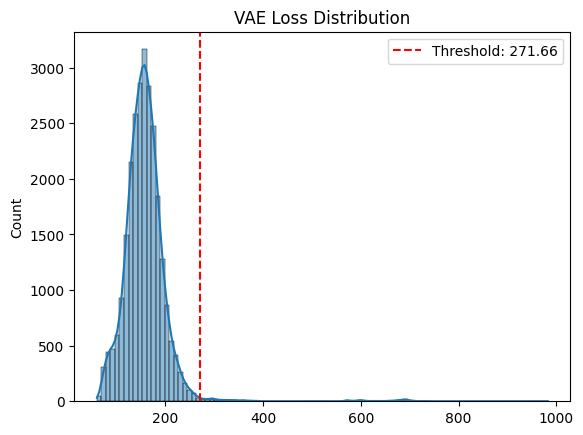

In [13]:
import seaborn as sns
import numpy as np

# Compute losses using the VAE loss function
with torch.no_grad():
    x_hat, mean, log_var = model(data_test)
    # Calculate individual losses for each sample
    reconstruction_loss = nn.functional.binary_cross_entropy(x_hat, data_test, reduction='none').sum(dim=1)
    kld_loss = -0.5 * torch.sum(1 + log_var - mean.pow(2) - log_var.exp(), dim=1)
    # Total loss per sample
    losses = (reconstruction_loss + kld_loss).cpu().numpy()

# Choose the treshold value when you think this becomes strange, I chose 99%
threshold = np.percentile(losses, 99)
print(f"Threshold value at {99} percentile: {threshold:.2f}")
sns.histplot(losses, bins=100, kde=True)
plt.axvline(x=threshold, color='r', linestyle='--', label=f'Threshold: {threshold:.2f}')
plt.title('VAE Loss Distribution')
plt.legend()
plt.show()

torch.Size([254, 1024])


C:\Users\User\AppData\Local\Temp\ipykernel_26476\3043178262.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 4))


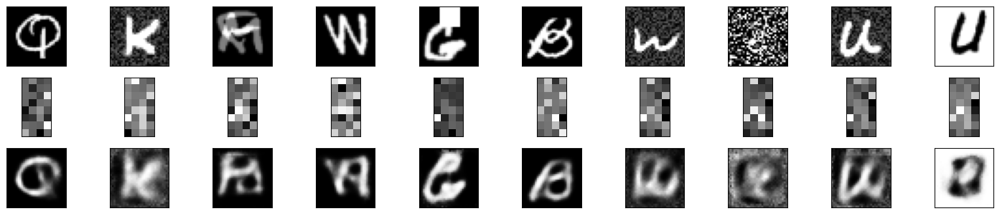

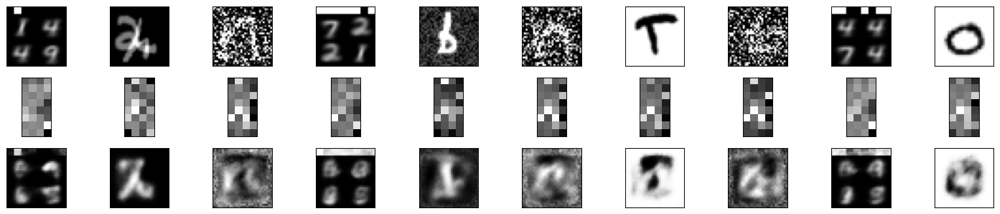

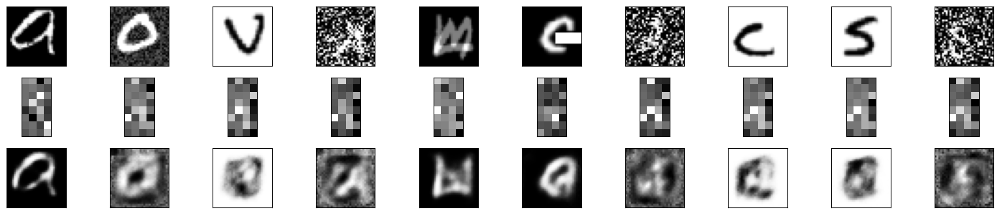

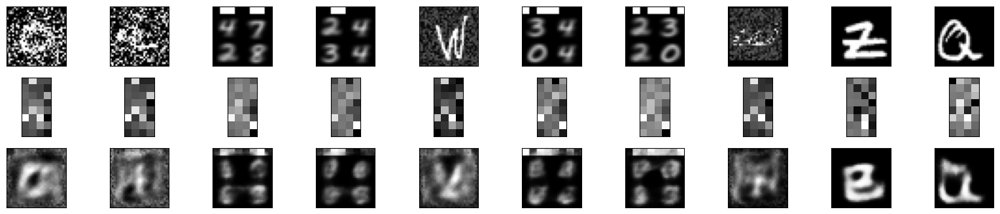

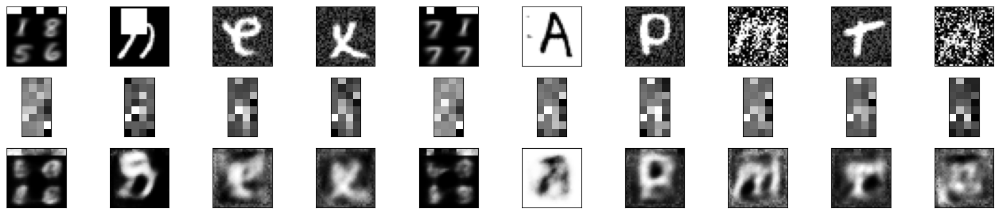

...

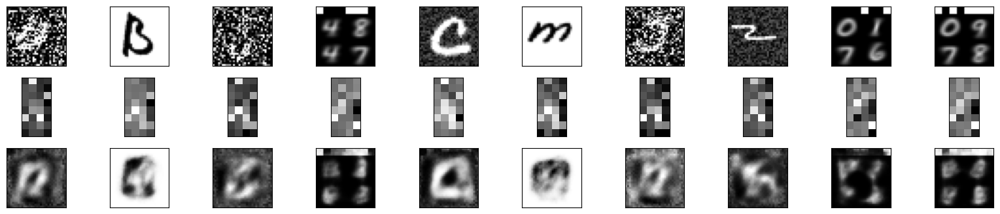

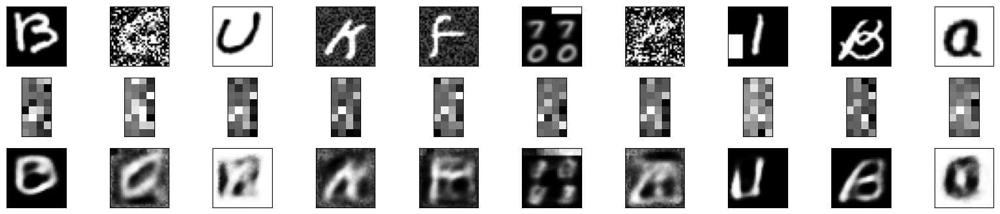

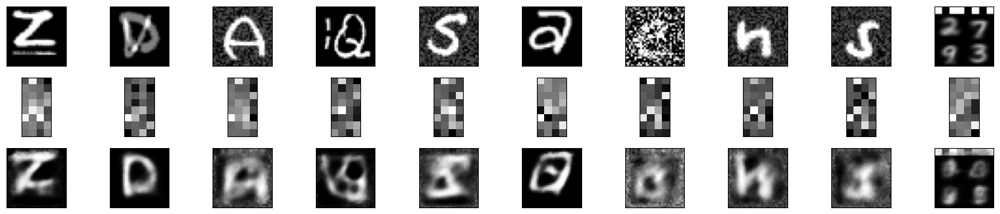

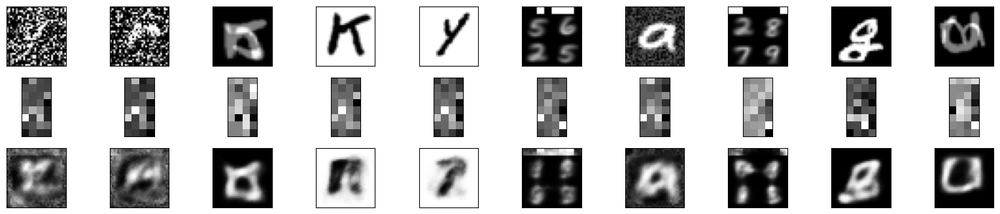

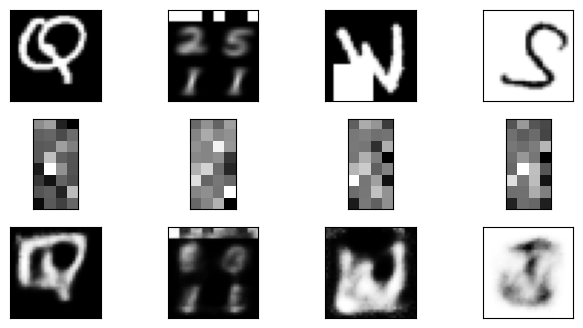

In [15]:
from utils import to_img

mask = losses > 275
outliers = data_test[mask]
print(outliers.shape)
plot_reconstructions3(model, outliers)

### Visualizing encoded structures

c:\Users\User\Mon Drive\DSB\2A HEC\Unsupervised DL\denoising_emnist\.venv\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 26212 samples in 0.016s...


c:\Users\User\Mon Drive\DSB\2A HEC\Unsupervised DL\denoising_emnist\.venv\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\User\Mon Drive\DSB\2A HEC\Unsupervised DL\denoising_emnist\.venv\Lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


[t-SNE] Computed neighbors for 26212 samples in 9.332s...
[t-SNE] Computed conditional probabilities for sample 1000 / 26212
[t-SNE] Computed conditional probabilities for sample 2000 / 26212
[t-SNE] Computed conditional probabilities for sample 3000 / 26212
[t-SNE] Computed conditional probabilities for sample 4000 / 26212
[t-SNE] Computed conditional probabilities for sample 5000 / 26212
[t-SNE] Computed conditional probabilities for sample 6000 / 26212
[t-SNE] Computed conditional probabilities for sample 7000 / 26212
[t-SNE] Computed conditional probabilities for sample 8000 / 26212
[t-SNE] Computed conditional probabilities for sample 9000 / 26212
[t-SNE] Computed conditional probabilities for sample 10000 / 26212
[t-SNE] Computed conditional probabilities for sample 11000 / 26212
[t-SNE] Computed conditional probabilities for sample 12000 / 26212
[t-SNE] Computed conditional probabilities for sample 13000 / 26212
[t-SNE] Computed conditional probabilities for sample 14000 / 26212

C:\Users\User\AppData\Local\Temp\ipykernel_26476\1544433371.py:14: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(data_tsne[:, 0], data_tsne[:, 1], cmap='viridis', s=10)  # Adjust 'c=labels' as needed


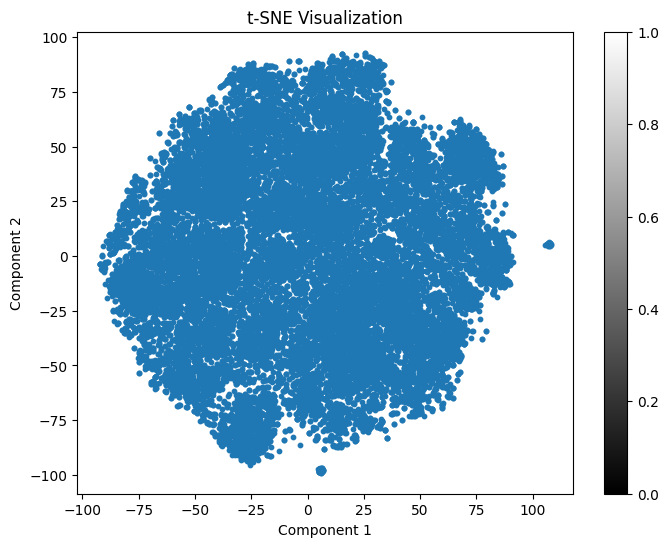

In [16]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

with torch.no_grad(): 
    mean, log_var = model.Encoder(loaded_images_nn)


# Step 2: Apply t-SNE
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=1000, verbose=2, n_jobs=-1)  
data_tsne = tsne.fit_transform(data_test.cpu().numpy())

# Step 3: Visualize
plt.figure(figsize=(8, 6))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1], cmap='viridis', s=10)  # Adjust 'c=labels' as needed
plt.colorbar()
plt.title('t-SNE Visualization')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.show()


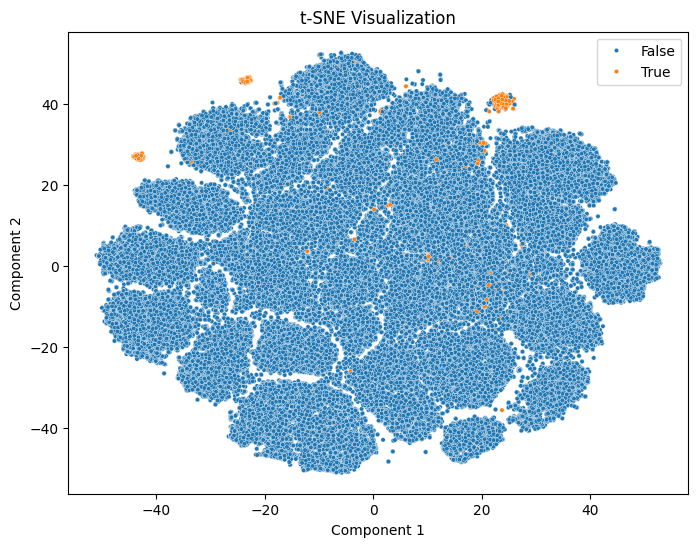

In [93]:
# Step 3: Visualize
plt.figure(figsize=(8, 6))
sns.scatterplot(x=data_tsne[:, 0], y=data_tsne[:, 1], s=10, hue=mask)  # Adjust 'c=labels' as needed
plt.title('t-SNE Visualization')
plt.xlabel('Component 1')
plt.ylabel('Component 2')


plt.show()

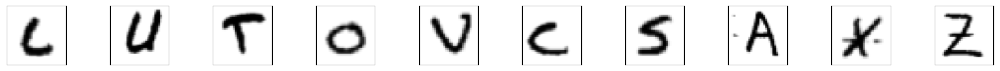

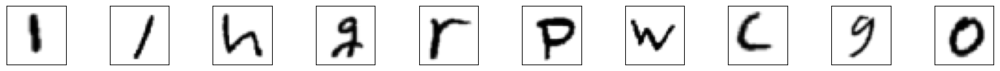

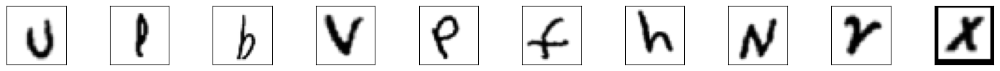

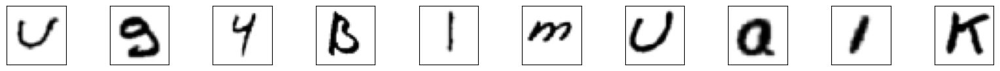

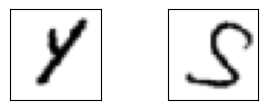

...

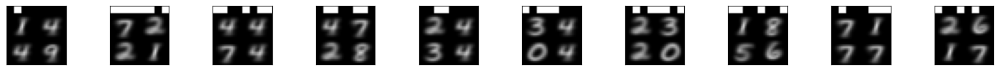

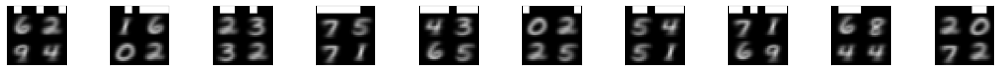

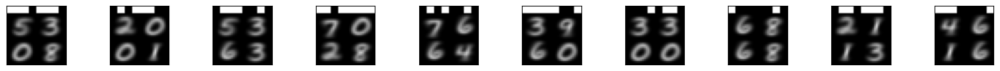

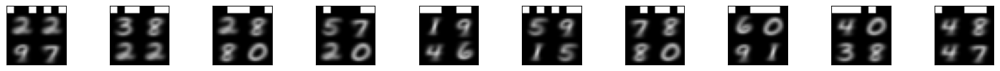

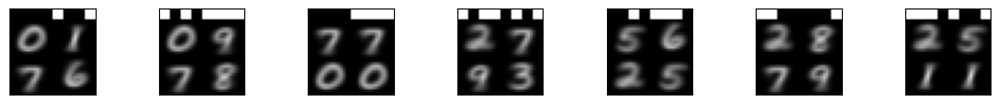

177


In [30]:
from utils import plot_images
center_1 = [107, 7]
center_2 = [-4, -14]
center_3 = [6, -95]

radius = 5
total_identified = 0

for center in [center_1, center_2, center_3]:
    mask = (data_tsne[:, 0] - center[0])**2 + (data_tsne[:, 1] - center[1])**2 < radius**2
    total_identified += mask.sum()
    plot_images(data_test[mask])
    plt.show()
    
print(total_identified)

c:\Users\User\Mon Drive\DSB\2A HEC\Unsupervised DL\denoising_emnist\.venv\Lib\site-packages\sklearn\manifold\_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 131057 samples in 0.000s...
[t-SNE] Computed neighbors for 131057 samples in 27.964s...
[t-SNE] Computed conditional probabilities for sample 1000 / 131057
[t-SNE] Computed conditional probabilities for sample 2000 / 131057
[t-SNE] Computed conditional probabilities for sample 3000 / 131057
[t-SNE] Computed conditional probabilities for sample 4000 / 131057
[t-SNE] Computed conditional probabilities for sample 5000 / 131057
[t-SNE] Computed conditional probabilities for sample 6000 / 131057
[t-SNE] Computed conditional probabilities for sample 7000 / 131057
[t-SNE] Computed conditional probabilities for sample 8000 / 131057
[t-SNE] Computed conditional probabilities for sample 9000 / 131057
[t-SNE] Computed conditional probabilities for sample 10000 / 131057
[t-SNE] Computed conditional probabilities for sample 11000 / 131057
[t-SNE] Computed conditional probabilities for sample 12000 / 131057
[t-SNE] Computed conditional probab

C:\Users\User\AppData\Local\Temp\ipykernel_26476\3676875149.py:15: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  plt.scatter(data_tsne[:, 0], data_tsne[:, 1], cmap='viridis', s=10)  # Adjust 'c=labels' as needed


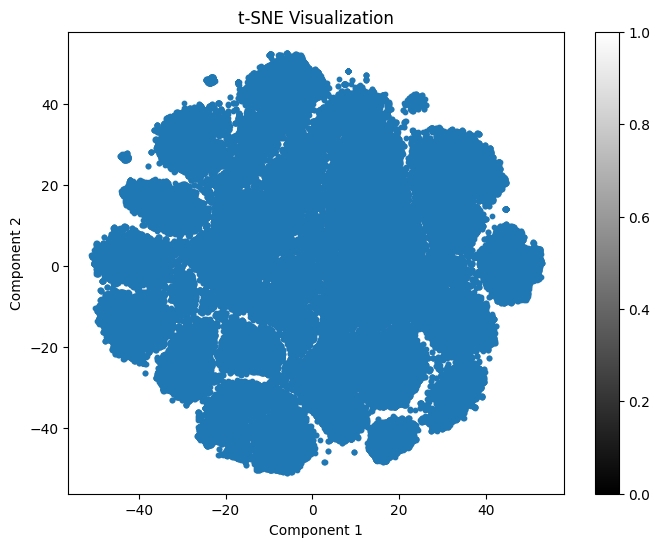

In [37]:
with torch.no_grad(): 
    mean, log_var = model.Encoder(loaded_images_nn)

from sklearn.manifold import TSNE
import matplotlib.pyplot as plt



# Step 2: Apply t-SNE
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=500, verbose=2, n_jobs=-1)  
data_tsne = tsne.fit_transform(mean.cpu().numpy())

# Step 3: Visualize
plt.figure(figsize=(8, 6))
plt.scatter(data_tsne[:, 0], data_tsne[:, 1], cmap='viridis', s=10)  # Adjust 'c=labels' as needed
plt.colorbar()
plt.title('t-SNE Visualization')
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.show()


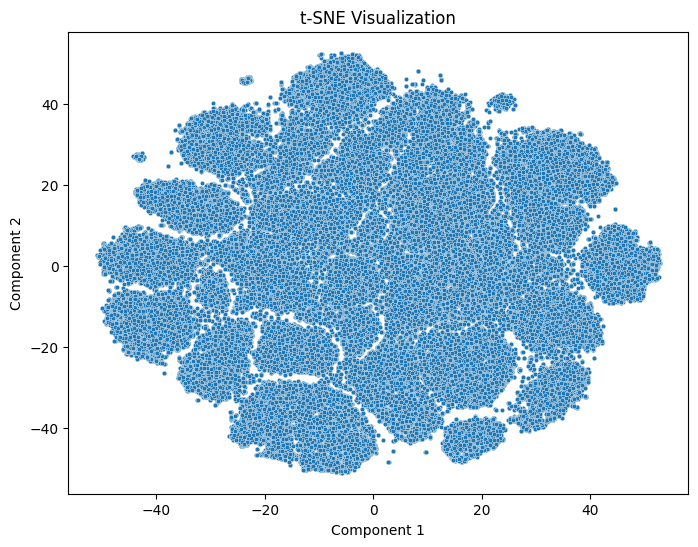

In [40]:
# Step 3: Visualize
plt.figure(figsize=(8, 6))
sns.scatterplot(x=data_tsne[:, 0], y=data_tsne[:, 1], s=10)  # Adjust 'c=labels' as needed
plt.title('t-SNE Visualization')
plt.xlabel('Component 1')
plt.ylabel('Component 2')


plt.show()

Threshold value at 99 percentile: 271.36


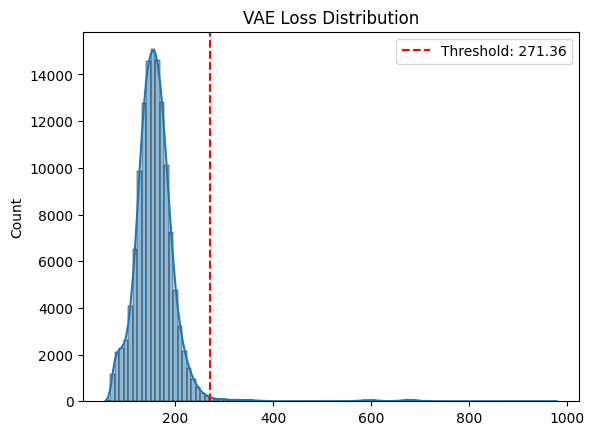

In [44]:
# Compute losses using the VAE loss function
with torch.no_grad():
    x_hat, mean, log_var = model(loaded_images_nn)
    # Calculate individual losses for each sample
    reconstruction_loss = nn.functional.binary_cross_entropy(x_hat, loaded_images_nn, reduction='none').sum(dim=1)
    kld_loss = -0.5 * torch.sum(1 + log_var - mean.pow(2) - log_var.exp(), dim=1)
    # Total loss per sample
    losses = (reconstruction_loss + kld_loss).cpu().numpy()

# Choose the treshold value when you think this becomes strange, I chose 99%
threshold = np.percentile(losses, 99)
print(f"Threshold value at {99} percentile: {threshold:.2f}")
sns.histplot(losses, bins=100, kde=True)
plt.axvline(x=threshold, color='r', linestyle='--', label=f'Threshold: {threshold:.2f}')
plt.title('VAE Loss Distribution')
plt.legend()
plt.show()

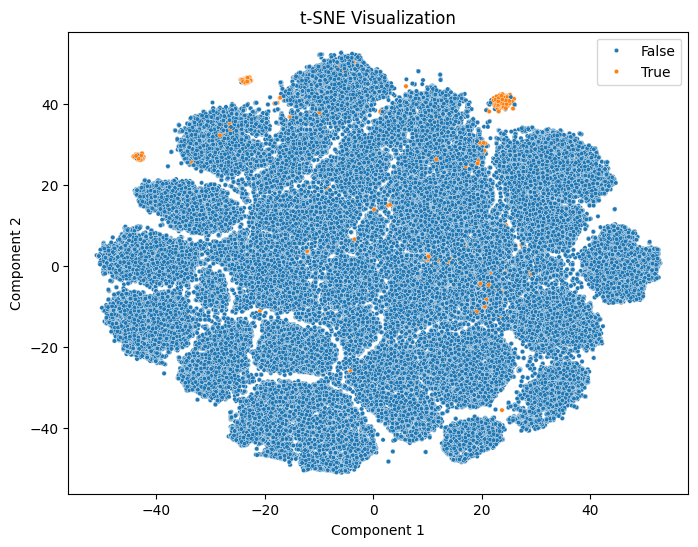

In [53]:
mask = losses > threshold

# Step 3: Visualize
plt.figure(figsize=(8, 6))
sns.scatterplot(x=data_tsne[:, 0], y=data_tsne[:, 1], s=10, hue=mask)  # Adjust 'c=labels' as needed
plt.title('t-SNE Visualization')
plt.xlabel('Component 1')
plt.ylabel('Component 2')

plt.show()

Threshold value at 99 percentile: 231.45


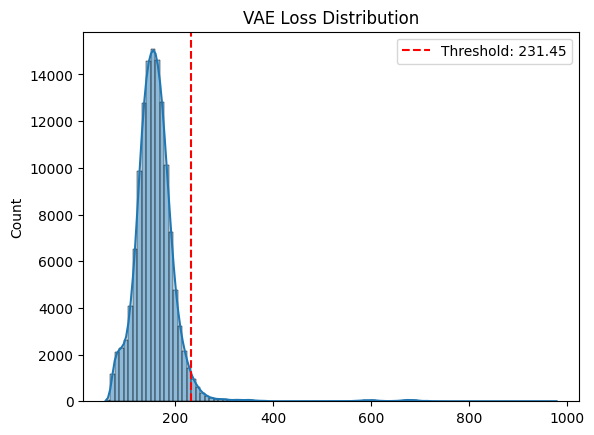

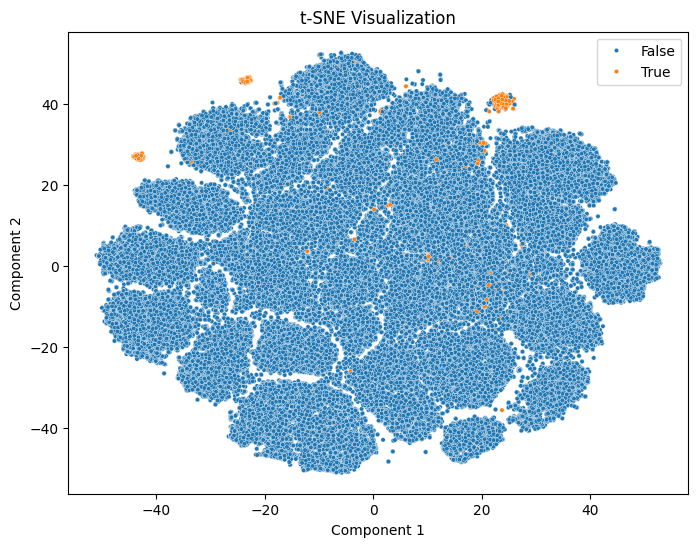

In [81]:
# using only reconstruction loss
# Compute losses using the VAE loss function
with torch.no_grad():
    x_hat, mean, log_var = model(loaded_images_nn)
    # Calculate individual losses for each sample
    reconstruction_loss = nn.functional.binary_cross_entropy(x_hat, loaded_images_nn, reduction='none').sum(dim=1)


# Choose the treshold value when you think this becomes strange, I chose 99%
threshold = np.percentile(reconstruction_loss, 99)
print(f"Threshold value at {99} percentile: {threshold:.2f}")
sns.histplot(losses, bins=100, kde=True)
plt.axvline(x=threshold, color='r', linestyle='--', label=f'Threshold: {threshold:.2f}')
plt.title('VAE Loss Distribution')
plt.legend()
plt.show()

threshold = 275
mask = losses > threshold

# Step 3: Visualize
plt.figure(figsize=(8, 6))
sns.scatterplot(x=data_tsne[:, 0], y=data_tsne[:, 1], s=10, hue=mask)  # Adjust 'c=labels' as needed
plt.title('t-SNE Visualization')
plt.xlabel('Component 1')
plt.ylabel('Component 2')

plt.show()

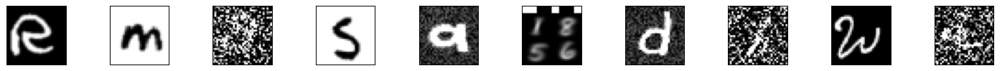

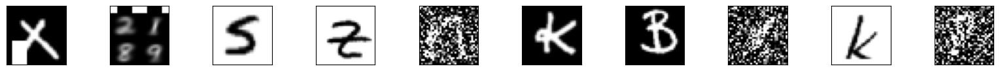

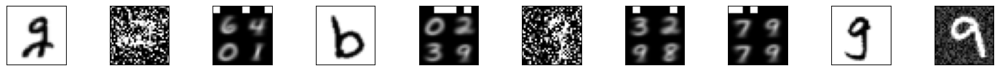

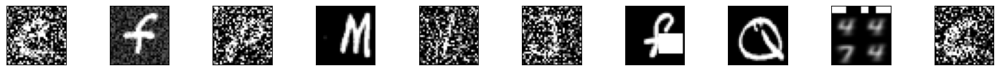

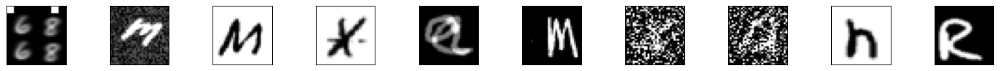

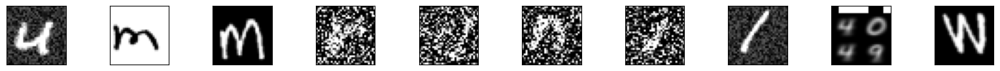

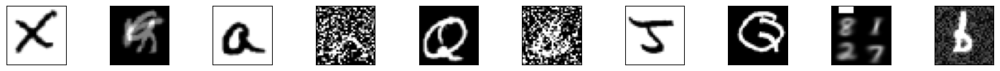

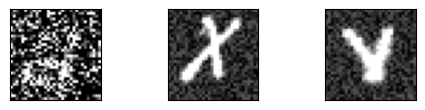

177


In [82]:
filter = np.arange(len(mask)) < 10_000
plot_images(loaded_images_nn[mask & filter])
plt.show()
    
print(total_identified)

### VAE CNN 

Structure inspired from [here](https://github.com/sksq96/pytorch-vae/blob/master/vae-cnn.ipynb)

In [18]:
import torch.nn as nn
import torch.nn.functional as F

class Flatten(nn.Module):
    def forward(self, input):
        return input.view(input.size(0), -1)

class UnFlatten(nn.Module):
    def forward(self, input):
        return input.view(input.size(0), input.size(1), 1, 1)

In [30]:
class Encoder(nn.Module):
    def __init__(self, input_dim=1024, h_dim=1024, latent_dim=32):
        super(Encoder, self).__init__()
        self.img_size = int(np.sqrt(input_dim))
        
        self.encoder = nn.Sequential(
            nn.Conv2d(1, 32, kernel_size=3, stride=2, padding=1), 
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
            nn.ReLU(),
            Flatten()
        )
        
        # Calculate the size after convolutions
        conv_size = 256 * (self.img_size//(2**4)) * (self.img_size//(2**4))
        
        self.FC_mean = nn.Linear(conv_size, latent_dim)
        self.FC_var = nn.Linear(conv_size, latent_dim)
        
    def forward(self, x):
        if len(x.shape) == 2:
            x = x.view(-1, 1, self.img_size, self.img_size)
        h = self.encoder(x)
        mean = self.FC_mean(h)
        log_var = self.FC_var(h)
        return mean, log_var

class Decoder(nn.Module):
    def __init__(self, input_dim=1024, h_dim=1024, latent_dim=32):
        super(Decoder, self).__init__()
        self.img_size = int(np.sqrt(input_dim))
        
        # Calculate the size needed for reshape
        self.init_size = self.img_size//(2**4)
        self.conv_size = 256 * self.init_size * self.init_size
        
        self.FC_hidden = nn.Linear(latent_dim, self.conv_size)
        
        self.decoder = nn.Sequential(
            Reshape(-1, 256, self.init_size, self.init_size), 
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(32, 1, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid(),
        )
    
    def forward(self, x):
        h = self.FC_hidden(x)
        x_hat = self.decoder(h)
        return x_hat.view(-1, self.img_size * self.img_size)

# Helper class for reshaping
class Reshape(nn.Module):
    def __init__(self, *args):
        super(Reshape, self).__init__()
        self.shape = args

    def forward(self, x):
        return x.view(self.shape)

class Model(nn.Module):
    def __init__(self, Encoder, Decoder):
        super(Model, self).__init__()
        self.Encoder = Encoder
        self.Decoder = Decoder
        
    def reparameterization(self, mean, var):
        epsilon = torch.randn_like(var).to(device)
        z = mean + var*epsilon
        return z
        
    def forward(self, x):
        mean, log_var = self.Encoder(x)
        z = self.reparameterization(mean, torch.exp(0.5 * log_var))
        x_hat = self.Decoder(z)
        return x_hat, mean, log_var

In [31]:
encoder = Encoder(input_dim=32*32, h_dim=1024, latent_dim=32)
decoder = Decoder(input_dim=32*32, h_dim=1024, latent_dim=32)
model = Model(Encoder=encoder, Decoder=decoder).to(device)

In [32]:
def train_model_cnnvae(model, loss_fn, data_loader=None, epochs=10, optimizer=None):
    model.train()
    for epoch in range(epochs):
        total_loss = 0
        total_bce = 0
        total_kld = 0
        for batch_idx, data in enumerate(train_loader):
            optimizer.zero_grad()
            # Get all outputs from the model
            x_hat, mean, log_var = model(data)  # Now properly unpacking all three values
            # Calculate loss using all outputs and get individual components
            loss, bce, kld = loss_fn(x_hat, data, mean, log_var)  # Note the order of arguments
            loss.backward()
            optimizer.step()
            
            # Accumulate losses
            total_loss += loss.item()
            total_bce += bce.item()
            total_kld += kld.item()
            
            if batch_idx % 100 == 0:
                print('Train Epoch: {} [{}/{} ({:.0f}%)]\tLoss: {:.6f}\tBCE: {:.6f}\tKLD: {:.6f}'.format(
                    epoch, 
                    batch_idx * len(data), 
                    len(data_loader.dataset),
                    100. * batch_idx / len(data_loader), 
                    loss.item(),
                    bce.item(),
                    kld.item()
                ))
        
        # Print epoch summary
        avg_loss = total_loss / len(data_loader)
        avg_bce = total_bce / len(data_loader)
        avg_kld = total_kld / len(data_loader)
        print(f'====> Epoch: {epoch} Average loss: {avg_loss:.4f} BCE: {avg_bce:.4f} KLD: {avg_kld:.4f}')

In [33]:
def loss_fn(recon_x, x, mu, logvar):
    BCE = F.binary_cross_entropy(recon_x, x, size_average=False)
    # BCE = F.mse_loss(recon_x, x, size_average=False)
    # 0.5 * sum(1 + log(sigma^2) - mu^2 - sigma^2)
    KLD = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())

    return BCE + KLD, BCE, KLD

In [39]:
optimizer = Adam(model.parameters(), lr=1e-3)
train_model_cnnvae(model, loss_fn, data_loader=train_loader, epochs=10, optimizer=optimizer)

/Users/charlesdecian/Documents/DL_projet/denoising_emnist/dl_project_denoising/lib/python3.11/site-packages/torch/nn/_reduction.py:51: UserWarning: size_average and reduce args will be deprecated, please use reduction='sum' instead.
  warnings.warn(warning.format(ret))


Train Epoch: 0 [0/104845 (0%)]	Loss: 37083.761719	BCE: 37067.078125	KLD: 16.684994
Train Epoch: 0 [25600/104845 (24%)]	Loss: 34144.511719	BCE: 34128.539062	KLD: 15.974111
Train Epoch: 0 [51200/104845 (49%)]	Loss: 32449.761719	BCE: 32434.335938	KLD: 15.425894
Train Epoch: 0 [76800/104845 (73%)]	Loss: 31606.964844	BCE: 31592.027344	KLD: 14.937660
Train Epoch: 0 [102400/104845 (98%)]	Loss: 29986.447266	BCE: 29972.058594	KLD: 14.387926
====> Epoch: 0 Average loss: 33844.4512 BCE: 33829.6190 KLD: 14.8321
Train Epoch: 1 [0/104845 (0%)]	Loss: 31696.859375	BCE: 31682.974609	KLD: 13.884538
Train Epoch: 1 [25600/104845 (24%)]	Loss: 29082.185547	BCE: 29068.445312	KLD: 13.739920
Train Epoch: 1 [51200/104845 (49%)]	Loss: 28973.673828	BCE: 28961.242188	KLD: 12.431475
Train Epoch: 1 [76800/104845 (73%)]	Loss: 29786.380859	BCE: 29773.660156	KLD: 12.720338
Train Epoch: 1 [102400/104845 (98%)]	Loss: 28166.847656	BCE: 28154.359375	KLD: 12.488516
====> Epoch: 1 Average loss: 29111.3940 BCE: 29098.4203 KLD

In [40]:
from utils import to_img

def plot_reconstructions4(model, data, base_dim=32):
    """
    Plot reconstructions from a dataset set.
    The top row is the original digits,
    the middle row is the encoded vector,
    and the bottom row is the decoder reconstruction.
    """
    
    true_imgs = data
    
    # Get the encodings and reconstructions from the VAE
    with torch.no_grad(): 
        # Get encodings and reconstruction
        mean, log_var = model.Encoder(data)
        z = model.reparameterization(mean, torch.exp(0.5 * log_var))
        decoded_imgs = model.Decoder(z)

    # Convert images for plotting
    true_imgs = to_img(true_imgs, base_dim=base_dim)
    decoded_imgs = to_img(decoded_imgs, base_dim=base_dim)
    # For VAE, we'll show the mean values of the latent space
    encoded_imgs = mean.cpu().data.numpy()

    n = 10  # Number of images to display at the same time
    for j in range(0, len(data), 10):
        plt.figure(figsize=(20, 4))
        for i in range(n):
            if i+j >= len(data):
                break
            # Display original images
            ax = plt.subplot(3, n, i + 1)
            plt.imshow(true_imgs[i + j])
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            # Display encoded representations (mean values)
            ax = plt.subplot(3, n, i + 1 + n)
            # Reshape latent space visualization based on latent_dim
            latent_dim = encoded_imgs.shape[1]
            reshape_dim = int(np.sqrt(latent_dim))
            if latent_dim == 32:  # If using 32 latent dimensions
                plt.imshow(encoded_imgs[i + j].reshape(4, 8))  # 4x8 = 32
            else:
                plt.imshow(encoded_imgs[i + j].reshape(reshape_dim, -1))
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

            # Display reconstructed images
            ax = plt.subplot(3, n, i + 1 + 2 * n)
            plt.imshow(decoded_imgs[i + j])
            plt.gray()
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)

/var/folders/3l/_hdyb1rx2yq_frxtjyy_t_7m0000gn/T/ipykernel_30781/3436313636.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 4))


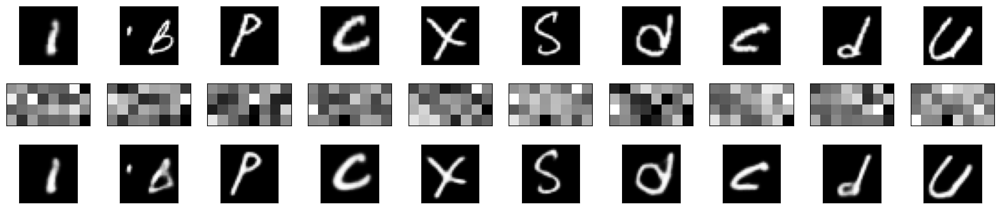

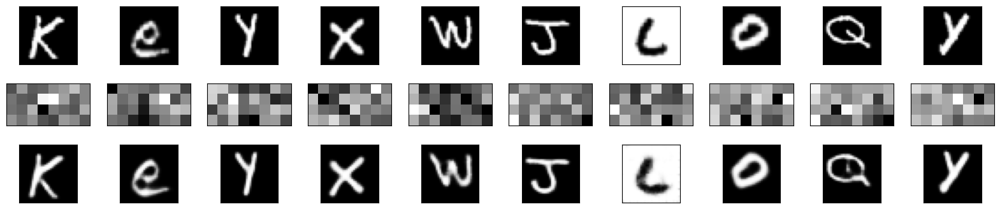

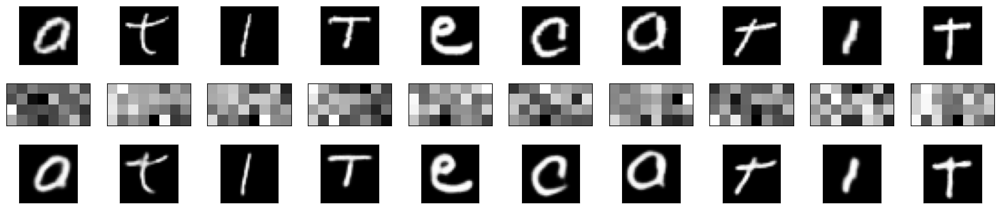

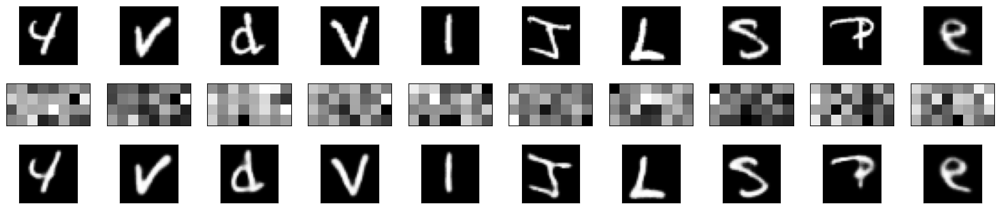

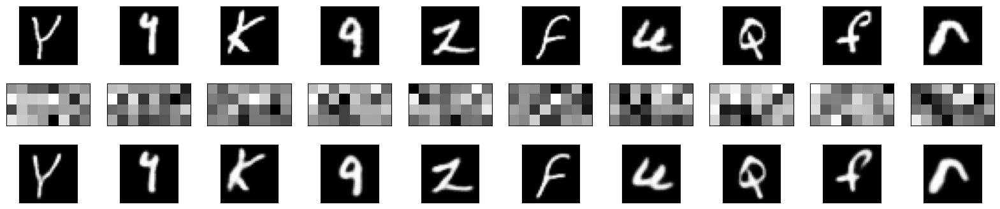

...

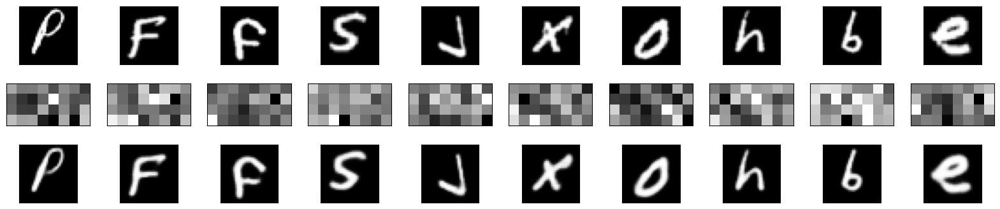

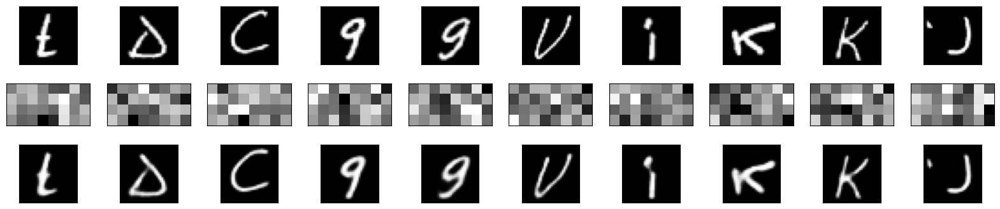

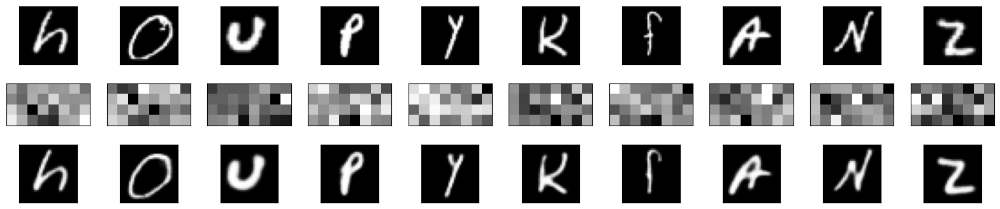

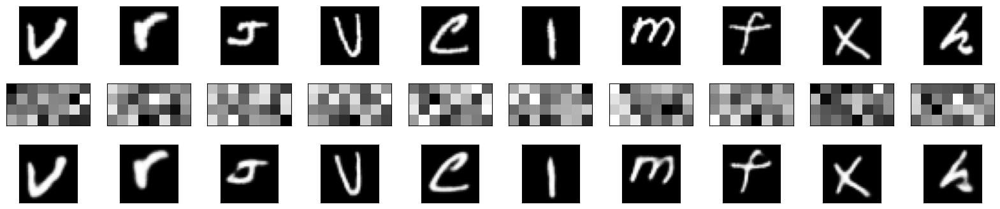

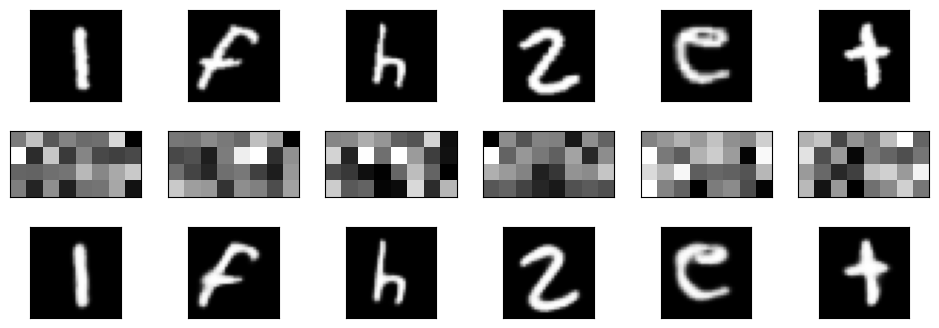

In [41]:
data_viz = next(iter(test_loader))
plot_reconstructions4(model, data_viz)

Threshold value at 99 percentile: 486.16


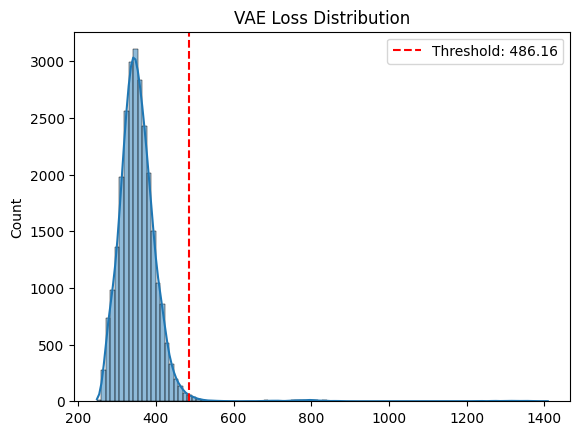

In [42]:
import seaborn as sns
import numpy as np

with torch.no_grad():
    x_hat, mean, log_var = model(data_test)
    reconstruction_loss = nn.functional.binary_cross_entropy(x_hat, data_test, reduction='none').sum(dim=1)
    kld_loss = -0.5 * torch.sum(1 + log_var - mean.pow(2) - log_var.exp(), dim=1)
    losses = (reconstruction_loss + kld_loss).cpu().numpy()

threshold = np.percentile(losses, 99)
print(f"Threshold value at {99} percentile: {threshold:.2f}")
sns.histplot(losses, bins=100, kde=True)
plt.axvline(x=threshold, color='r', linestyle='--', label=f'Threshold: {threshold:.2f}')
plt.title('VAE Loss Distribution')
plt.legend()
plt.show()

torch.Size([212, 1024])


/var/folders/3l/_hdyb1rx2yq_frxtjyy_t_7m0000gn/T/ipykernel_30781/3436313636.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 4))


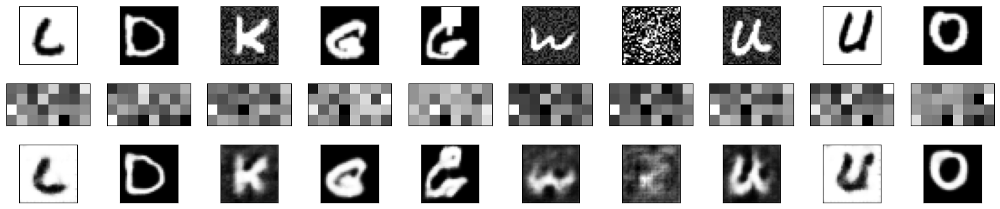

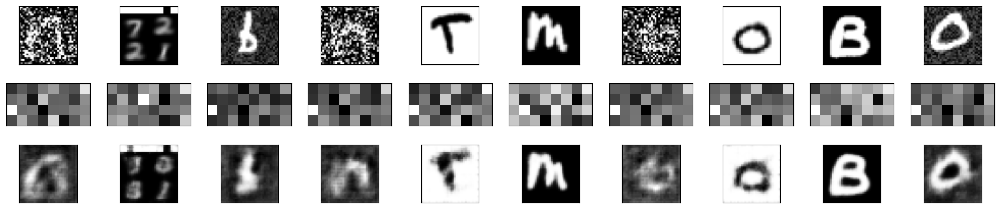

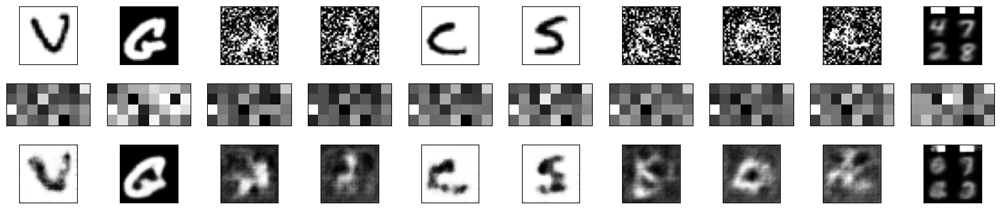

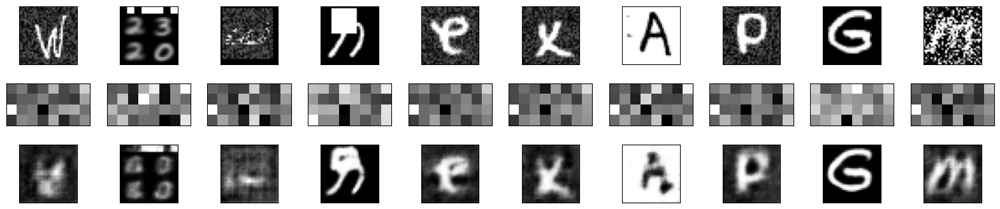

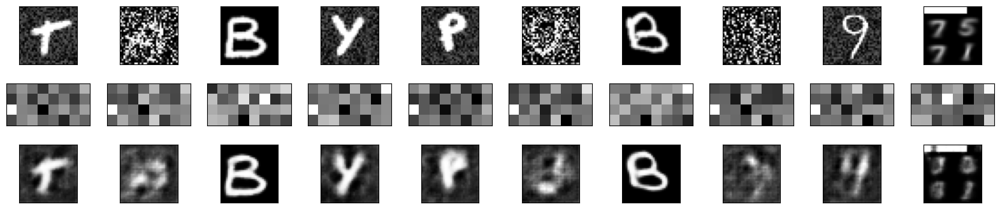

...

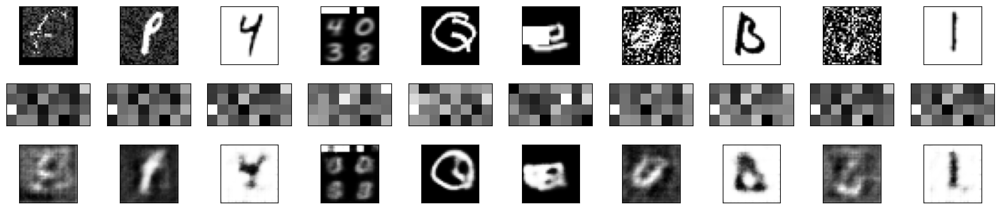

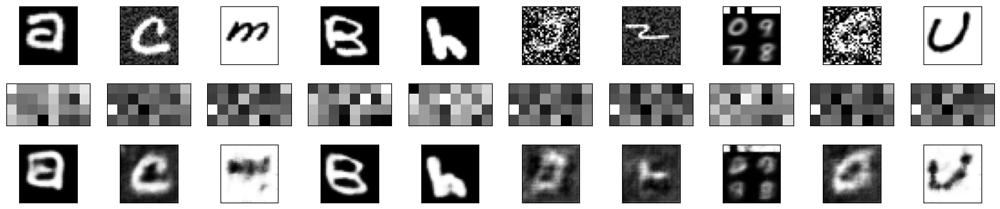

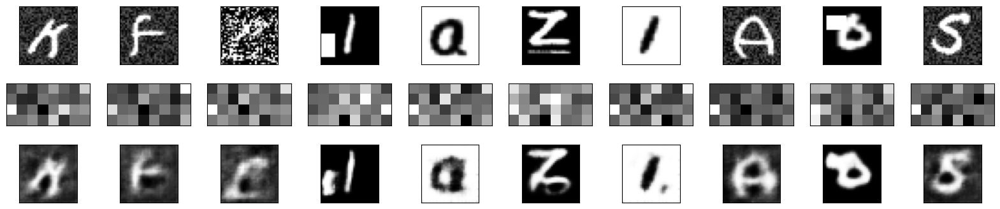

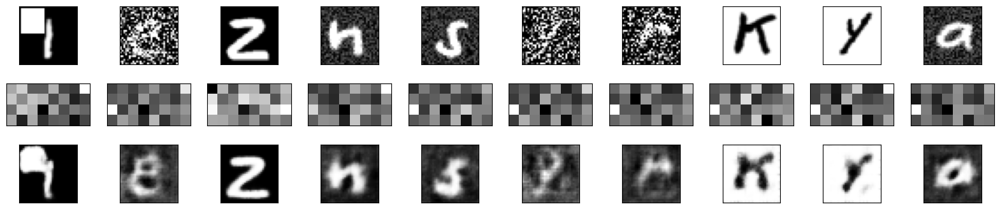

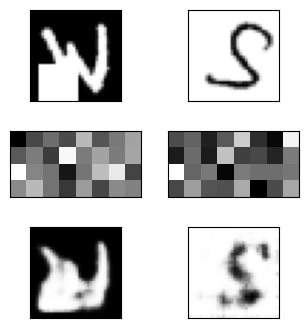

In [44]:
mask = losses > 500
outliers = data_test[mask]
print(outliers.shape)
plot_reconstructions4(model, outliers)

Je trouve ça moins bien que le précédent car ce CNN VAE reconnaît autant d'images corrompues mais en en incluant plus qui ne le sont pas 

A voir si le trick via la loss est encore pertinent avec un CNN VAE 